In [236]:
import AGG
import pysam
from collections import defaultdict
import pandas as pd
import seaborn as sns

In [237]:
bamfile = "./mt_test.bam"
graphfile = "./mt_test.annotated.gfa"


In [238]:
graph = AGG.GraphicalGenome(graphfile)

In [247]:
def find_path_on_graph(graph, read_name):
    node = "SOURCE"
    anchorlist = sorted(graph.anchor.keys()) # reference path
    path_items = []

    while node not in path_items and node != "SINK":
        print(node)
        for edge in graph.outgoing[node]:
            if read_name in graph.edges[edge]['reads']:
                path_items += [node, edge]
                node = graph.edges[edge]["dst"][0]
                break
        else:
            if node == "SOURCE":
                node = anchorlist[0]
            else:
                for i, anchor in enumerate(anchorlist):
                    if anchor == node:
                        node = anchorlist[i+1]
    return path_items





In [246]:
# path_items

In [ ]:

bam_file = pysam.AlignmentFile(bamfile, "rb")
mod = "m"
read_set = set()
# an example edge
for read in bam_file.fetch('chrM'):
    if read.is_unmapped:
        continue   
    read_name = read.query_name
    print(read_name)
    if read_name in read_set:
        continue
    read_set.add(read_name)
    forward_contig = read.query_sequence
    if not read.is_forward:
        forward_contig = reverse_complement(read.query_sequence)
    break

# registration
path_items = find_path_on_graph(graph, read_name)
anchor_list = [item for item in path_items if item.startswith("A")]

Anchorseq = {graph.anchor[anchor]['seq']:anchor for anchor in anchor_list}
k = len(graph.anchor[anchor_list[0]]['seq'])

# mapping anchor to reads
PositionDict = defaultdict(list)
for anchor_seq, anchor_name in Anchorseq.items():
    anchor_rev = reverse_complement(anchor_seq)
    PositionDict[anchor_seq]
    PositionDict[anchor_rev]

for i in range(1, len(forward_contig) - k + 1):
    kmer = forward_contig[i:i+k]
    if kmer in PositionDict:
        PositionDict[kmer] = PositionDict.get(kmer, []) + [i]

# exclude multiple mapping
final_anchor = {}
for anchor in anchor_list:
    anchor_seq = graph.anchor[anchor]['seq']
    anchor_rev = reverse_complement(anchor_seq)
    poslist = PositionDict[anchor_seq] + PositionDict[anchor_rev]
    if len(PositionDict[anchor_seq]) == 1 and len(PositionDict[anchor_rev]) == 0:
        final_anchor[anchor] = poslist[0]

# find base pair level mapping between reads and graph entities
read_position_mapping = {}
# before first anchor
sorted_final_anchor = sorted(final_anchor.items(), key=lambda item: item[1])
if len(sorted_final_anchor) < 10:
    print(read_position_mapping) 
first_anchor_position, first_anchor = sorted_final_anchor[0]
# find the first edge
for edge in graph.incoming[first_anchor]:
    if read_name in graph.edges[edge]['reads']:
        # check sequence
        if graph.edges[edge]["seq"] == forward_contig[:first_anchor_position]:
            for first_pos in range(first_anchor_position):
                read_position_mapping[first_pos] = (edge, first_pos)

# middle
for read_position, anchor in sorted_final_anchor:
        for i in range(k):
            read_position_mapping[read_position + i] = (anchor, i) # anchor + offset
        # get connected edge
        edgelist = graph.outgoing[anchor]
        for edge in edgelist:
            if read_name in graph.edges[edge]["reads"]:
                dst = graph.outgoing[edge]["dst"]
                dst_pos = final_anchor[dst]
                if graph.edges[edge]['seq'] == forward_contig[read_position + k:]
                    edge_length = len(graph.edges[edge]['seq'])
                    for j in range(edge_length):
                        read_position_mapping[read_position + k + j] = (edge, j)


In [183]:
def get_mapping_position(graph, read_name, forward_contig):
    anchor_list = sorted(graph.anchor.keys())

    Anchorseq = {graph.anchor[anchor]['seq']:anchor for anchor in anchor_list}
    k = len(graph.anchor[anchor_list[0]]['seq'])
    
    # mapping anchor to reads
    PositionDict = defaultdict(list)
    for anchor_seq, anchor_name in Anchorseq.items():
        anchor_rev = reverse_complement(anchor_seq)
        PositionDict[anchor_seq]
        PositionDict[anchor_rev]

    for i in range(1, len(forward_contig) - k + 1):
        kmer = forward_contig[i:i+k]
        if kmer in PositionDict:
            PositionDict[kmer] = PositionDict.get(kmer, []) + [i]

    # exclude multiple mapping
    final_anchor = {}
    for anchor in anchor_list:
        anchor_seq = graph.anchor[anchor]['seq']
        anchor_rev = reverse_complement(anchor_seq)
        poslist = PositionDict[anchor_seq] + PositionDict[anchor_rev]
        if len(PositionDict[anchor_seq]) == 1 and len(PositionDict[anchor_rev]) == 0:
            final_anchor[poslist[0]] = anchor

    # find base pair level mapping between reads and graph entities
    read_position_mapping = {}
    # before first anchor
    sorted_final_anchor = [(pos, final_anchor[pos]) for pos in sorted(final_anchor.keys())]
    if len(sorted_final_anchor) < 10:
        return read_position_mapping
    first_anchor_position, first_anchor = sorted_final_anchor[0]
    # find the first edge
    for edge in graph.incoming[first_anchor]:
        if read_name in graph.edges[edge]['reads']:
            for first_pos in range(first_anchor_position):
                read_position_mapping[first_pos] = (edge, first_pos)

    # middle
    for read_position, anchor in sorted_final_anchor:
            for i in range(k):
                read_position_mapping[read_position + i] = (anchor, i) # anchor + offset
            # get connected edge
            edgelist = graph.outgoing[anchor]
            for edge in edgelist:
                if read_name in graph.edges[edge]["reads"]:
                    edge_length = len(graph.edges[edge]['seq'])
                    for j in range(edge_length):
                        read_position_mapping[read_position + k + j] = (edge, j)
                        # if anchor == sorted_final_anchor[-1][1]:
                        #     print(anchor, edge, read_position + k + j, graph.outgoing[edge],j)
                    
    return read_position_mapping

In [235]:
# validate read_position_mapping

bam_file = pysam.AlignmentFile(bamfile, "rb")
mod = "m"
read_set = set()

for read in bam_file.fetch('chrM'):
    if read.is_unmapped:
        continue   
    read_name = read.query_name
    print(read_name)
    break
    if read_name in read_set:
        continue
    read_set.add(read_name)
    query_sequence = read.query_sequence
    if not read.is_forward:
        query_sequence = reverse_complement(query_sequence)
    read_position_mapping = get_mapping_position(graph, read_name, query_sequence)
    # print(len(read_position_mapping))
    for position, (item, offset) in read_position_mapping.items():
        if item.startswith("A"):
            assert query_sequence[position] == graph.anchor[item]['seq'][offset], print(item, offset)
        elif item.startswith("E"):
            assert query_sequence[position] == graph.edges[item]['seq'][offset], print(item, offset)


m64011_190901_095311/1311733/ccs


In [184]:
# position
read_position_mapping

{16: ('A014058', 0),
 17: ('A014058', 1),
 18: ('A014058', 2),
 19: ('A014058', 3),
 20: ('A014058', 4),
 21: ('A014058', 5),
 22: ('A014058', 6),
 23: ('A014058', 7),
 24: ('A014058', 8),
 25: ('A014058', 9),
 26: ('A014058', 10),
 27: ('A014058', 11),
 28: ('A014058', 12),
 29: ('A014058', 13),
 30: ('A014058', 14),
 31: ('A014058', 15),
 32: ('A014058', 16),
 33: ('A014058', 17),
 34: ('A014058', 18),
 35: ('A014058', 19),
 36: ('A014058', 20),
 38: ('A014080', 0),
 39: ('A014080', 1),
 40: ('A014080', 2),
 41: ('A014080', 3),
 42: ('A014080', 4),
 43: ('A014080', 5),
 44: ('A014080', 6),
 45: ('A014080', 7),
 46: ('A014080', 8),
 47: ('A014080', 9),
 48: ('A014080', 10),
 49: ('A014080', 11),
 50: ('A014080', 12),
 51: ('A014080', 13),
 52: ('A014080', 14),
 53: ('A014080', 15),
 54: ('A014080', 16),
 55: ('A014080', 17),
 56: ('A014080', 18),
 57: ('A014080', 19),
 58: ('A014080', 20),
 59: ('E00001.0637', 0),
 60: ('A014102', 0),
 61: ('A014102', 1),
 62: ('A014102', 2),
 63: ('A

In [161]:
# graph.anchor[item]['pos'], graph.anchor[item]['seq'][offset], query_sequence[position], read.is_forward

In [185]:
def reverse_complement(kmer):
    return ''.join([{'A':'T','C':'G','G':'C','T':'A', "N":"N"}[base] for base in reversed(kmer)])

def get_methylation_read(read):
    methyl_pos_dict = {}
    if read.is_forward:
        forward_sequence = read.query_sequence
    else:
        forward_sequence = reverse_complement(read.query_sequence)

    if read.has_tag("Mm") or read.has_tag("Ml") or read.has_tag("MM") or read.has_tag("ML"):
        for modtype in read.modified_bases:
            if modtype[2] != mod:
                return methyl_pos_dict
            for pos, qual in read.modified_bases[modtype]:
                strand = modtype[1]
                if strand == 0 and read.is_forward:
                    if forward_sequence[pos] == "C":
                        methyl_pos_dict[pos] = qual/255.0
                else:
                    # reversed strand
                    forward_pos = read.query_length - pos - 1
                    if forward_sequence[forward_pos - 1] == "C":
                        methyl_pos_dict[forward_pos - 1] = qual/255.0
                    elif forward_sequence[forward_pos] == "C":
                        methyl_pos_dict[forward_pos] = qual/255.0
                    else:
                        print(methyl_pos_dict[forward_pos - 1 : forward_pos + 1])


    return methyl_pos_dict

In [186]:
# extracted the reference coordinates
from dataclasses import dataclass
from typing import List, Tuple

    
def get_mapping_coordinates(cigar: str, ref_start: int) :

    ref_pos = 0
    alt_pos = 0
    
    # Parse CIGAR string into operations
    operations = []
    num = ""
    for c in cigar:
        if c.isdigit():
            num += c
        else:
            operations.append((int(num), c))
            num = ""
    
    # Process each operation
    position_mapping = {}
    for length, op in operations:
        if op == '=' or op == "M":  # Match
            for i in range(length):
                pos = ref_start + ref_pos + i
                position_mapping[alt_pos + i] = pos
            ref_pos += length
            alt_pos += length
        elif op == 'X':  # Mismatch
            for i in range(length):
                pos = ref_start + ref_pos + i
                position_mapping[alt_pos + i] = pos
            ref_pos += length
            alt_pos += length

        elif op == 'I':  # Insertion
            pos = ref_start + ref_pos -1 # mapping to one base pair before
            for i in range(length):
                position_mapping[alt_pos + i] = pos
            alt_pos += length
            
        elif op == 'D':  # Deletion, nothing will map back to reference coordinates
            ref_pos += length
            
    return position_mapping



In [188]:
# annotate graph
bam_file = pysam.AlignmentFile(bamfile, "rb")
mod = "m"
Methyl = {}
read_set = set()
for read in bam_file.fetch('chrM'):
    if read.is_unmapped:
        continue   
    read_name = read.query_name
    if read_name in read_set:
        continue
    read_set.add(read_name)
    query_sequence = read.query_sequence
    if not read.is_forward:
        query_sequence = reverse_complement(query_sequence)
    methyl_pos_dict = get_methylation_read(read)
    # map anchor to sequence and generate a position map
    mapping_position = get_mapping_position(graph, read_name, query_sequence)
    if len(mapping_position) == 0:
        continue
    for pos, likelihood in methyl_pos_dict.items():
        if pos in mapping_position:
            item, offset = mapping_position[pos]
            if item.startswith("A"):
                assert graph.anchor[item]['seq'][offset] == "C", print(item, offset, graph.anchor[item]['seq'][offset])

                graph.anchor[item]["methyl"] = graph.anchor[item].get("methyl", {})
                graph.anchor[item]["methyl"][read_name] = graph.anchor[item]["methyl"].get(read_name, []) + [(offset, likelihood)]

            elif item.startswith("E"):
                assert graph.edges[item]['seq'][offset] == "C", print(item, offset, graph.edges[item]['seq'][offset])
                graph.edges[item]["methyl"] = graph.edges[item].get("methyl", {})
                graph.edges[item]["methyl"][read_name] = graph.edges[item]["methyl"].get(read_name, []) + [(offset, likelihood)]

            else:
                print(item, pos)




In [165]:
# graph.anchor['A008382']['seq'][16:18]
graph.anchor

{'A000022': {'pos': 22,
  'seq': 'TAACCACTCACGGGAGCTCTC',
  'methyl': {'m64011_190901_095311/1311733/ccs': [(10, 0.19607843137254902)],
   'm64011_190901_095311/1837241/ccs': [(10, 0.5098039215686274)],
   'm64011_190901_095311/3148195/ccs': [(10, 0.20784313725490197)],
   'm64011_190901_095311/4457474/ccs': [(10, 0.054901960784313725)],
   'm64011_190901_095311/4850369/ccs': [(10, 0.07450980392156863)],
   'm64011_190901_095311/7078145/ccs': [(10, 0.2549019607843137)],
   'm64011_190901_095311/7340639/ccs': [(10, 0.03529411764705882)],
   'm64011_190901_095311/8388851/ccs': [(10, 0.28627450980392155)],
   'm64011_190901_095311/8651920/ccs': [(10, 0.054901960784313725)],
   'm64011_190901_095311/10093491/ccs': [(10, 0.23137254901960785)],
   'm64011_190901_095311/12059462/ccs': [(10, 0.043137254901960784)],
   'm64011_190901_095311/12386919/ccs': [(10, 0.047058823529411764)],
   'm64011_190901_095311/12454301/ccs': [(10, 0.011764705882352941)],
   'm64011_190901_095311/12715030/ccs': [

In [189]:
def find_most_supported_edge(graph, src):
    outgoinglist = graph.outgoing[src]
    m = 0
    most_supported_edge = ""
    for edge in outgoinglist:
        read_count = len(graph.edges[edge]['reads'])
        if read_count > m:
            m = read_count
            most_supported_edge = edge

    return most_supported_edge

def construct_major_haplotype(graph):
    anchorlist = sorted(graph.anchor.keys())
    src = anchorlist[0]
    dst = anchorlist[-1]
    major_haplotype = []

    while dst > src:
        next_edge = find_most_supported_edge(graph, src)
        major_haplotype += [src, next_edge]
        src = graph.edges[next_edge]['dst'][0]
        
    next_edge = find_most_supported_edge(graph, src)
    major_haplotype += [src, next_edge]
    return major_haplotype

def construct_major_haplotype_sequence(graph):
    anchorlist = sorted(graph.anchor.keys())
    src = anchorlist[0]
    dst = anchorlist[-1]
    major_haplotype = ""
    while dst > src:
        next_edge = find_most_supported_edge(graph, src)
        major_haplotype += graph.anchor[src]['seq']
        major_haplotype += graph.edges[next_edge]['seq']
        src = graph.edges[next_edge]['dst'][0]

    next_edge = find_most_supported_edge(graph, src)
    major_haplotype += graph.anchor[src]['seq']
    major_haplotype += graph.edges[next_edge]['seq']
    return major_haplotype
    

In [205]:
# methylation signal on major haplotypes
bam_file = pysam.AlignmentFile(bamfile, "rb")
mod = "m"
Methyl = {}
read_set = set()
major_haplotype = construct_major_haplotype(graph)
major_haplotype_sequence = construct_major_haplotype_sequence(graph)
startpos = 0
k = 21
for item in major_haplotype:
    if item.startswith('A'):
        methyl_info_list = graph.anchor[item].get("methyl", {})
        seq = graph.anchor[item]['seq']
        cigar = "%s=" % str(k)
        ref_start = graph.anchor[item]['pos']
        reference_position_mapping = get_mapping_coordinates(cigar, ref_start)
    elif item.startswith("E"):
        methyl_info_list = graph.edges[item].get("methyl", {})
        seq = graph.edges[item]['seq']
        cigar = graph.edges[item].get("variants", "")
        src = graph.incoming[item][0]
        if src == "SOURCE":
            ref_start = 0
        else:
            ref_start = graph.anchor[src]['pos'] + k

        if len(cigar) == 0:
            reference_position_mapping = {}
        else:
            reference_position_mapping = get_mapping_coordinates(cigar, ref_start)
    
    else:
        methyl_info_list = {}
        reference_position_mapping = {}

    if len(methyl_info_list) == 0:
        startpos += len(seq)
        continue

    for read, infolist in methyl_info_list.items():
        for pos, likelihood in infolist:
            currentpos = startpos + pos
            referencepos = reference_position_mapping.get(pos)
            
            if currentpos >= len(major_haplotype_sequence) or major_haplotype_sequence[currentpos] != "C":
                print(f"Non-C base at pos {currentpos}: '{major_haplotype_sequence[currentpos] if currentpos < len(major_haplotype_sequence) else 'out of bounds'}'")
                print(f"Item: {item}, pos: {pos}, startpos: {startpos}")
                continue  # Skip this position instead of failing
                
            if currentpos + 1 >= len(major_haplotype_sequence) or major_haplotype_sequence[currentpos + 1] != "G":
                print(f"Non-G base at pos {currentpos+1}: '{major_haplotype_sequence[currentpos+1] if currentpos+1 < len(major_haplotype_sequence) else 'out of bounds'}'")
                print(f"Item: {item}, pos: {pos}, startpos: {startpos}")
                continue  # Skip this position instead of failing
            
            Methyl[(currentpos, referencepos)] = Methyl.get((currentpos, referencepos), {})
            Methyl[(currentpos, referencepos)][read] = likelihood
    
    startpos += len(seq)






Non-G base at pos 2201: 'T'
Item: A002200, pos: 20, startpos: 2180
Non-G base at pos 2311: 'C'
Item: A002310, pos: 20, startpos: 2290
Non-G base at pos 4004: 'A'
Item: A004004, pos: 20, startpos: 3983
Non-G base at pos 4642: 'C'
Item: A004642, pos: 20, startpos: 4621
Non-G base at pos 4642: 'C'
Item: A004642, pos: 20, startpos: 4621
Non-G base at pos 4642: 'C'
Item: A004642, pos: 20, startpos: 4621
Non-G base at pos 5214: 'C'
Item: A005214, pos: 20, startpos: 5193
Non-G base at pos 5214: 'C'
Item: A005214, pos: 20, startpos: 5193
Non-G base at pos 5214: 'C'
Item: A005214, pos: 20, startpos: 5193
Non-G base at pos 5214: 'C'
Item: A005214, pos: 20, startpos: 5193
Non-G base at pos 5214: 'C'
Item: A005214, pos: 20, startpos: 5193
Non-G base at pos 5214: 'C'
Item: A005214, pos: 20, startpos: 5193
Non-G base at pos 5214: 'C'
Item: A005214, pos: 20, startpos: 5193
Non-G base at pos 5214: 'C'
Item: A005214, pos: 20, startpos: 5193
Non-G base at pos 5214: 'C'
Item: A005214, pos: 20, startpos: 

In [206]:
currentpos, major_haplotype_sequence[currentpos]


(16543, 'C')

In [211]:
len(Methyl), major_haplotype_sequence.count("CG")

(437, 437)

<Axes: ylabel='Count'>

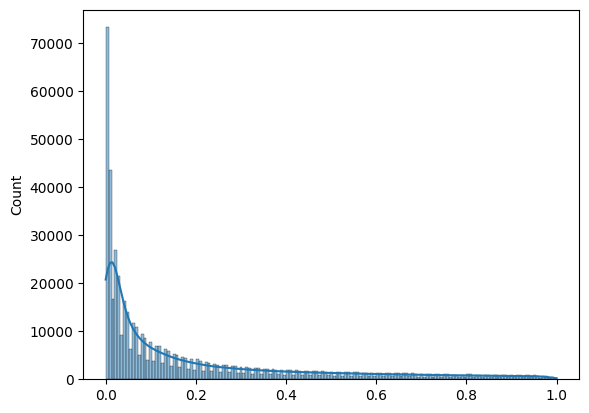

In [212]:
# aggregate all the likelihood
likelihood_list = []
for pos, D in Methyl.items():
    likelihood_list += list(D.values())
sns.histplot(likelihood_list, kde = True)


In [215]:
Coverage = {}
for pos, D in Methyl.items():
    Coverage[pos] = len(D)
# sns.pointplot(Coverage)
min_prob = 0.5
Methylation_signal = {}
for (pos, refpos), D in Methyl.items():
    methyl_count = 0
    unmethyl_count = 0
    total_count = 0
    for read, likelihood in D.items():
        if likelihood > min_prob:
            methyl_count += 1
        elif likelihood < 1 - min_prob:
            unmethyl_count += 1
        total_count += 1
    assert total_count == Coverage[(pos, refpos)]
    methyl_rate = methyl_count / float(total_count)
    unmethyl_rate = unmethyl_count / float(total_count)
    Methylation_signal[(pos, refpos)] = (methyl_rate, unmethyl_rate)


In [216]:
# overall methylated bases
methylated_bases = 0
for pos, (methyl, unmethyl) in Methylation_signal.items():
    # print(methyl, unmethyl)
    if methyl > 0.5:
        methylated_bases += 1
        print(pos, methyl)
methylated_bases

(1301, 1321) 0.5102404274265361


1

/Users/suhang/miniconda3/lib/python3.10/site-packages/umap_learn-0.5.5-py3.10.egg/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


(1426, 2)


Text(0, 0.5, 'umap_y')

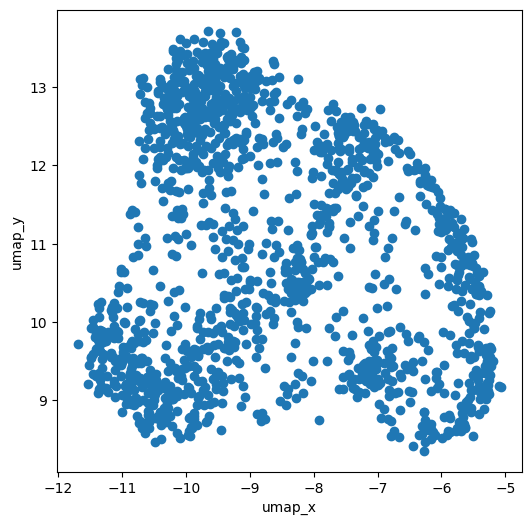

In [230]:
# splitted methylation signals per read
df = pd.DataFrame(Methyl)
df[df>min_prob] = 1
df[df<1-min_prob] = -1
df[df.isna()] = 0
matrix = df.values


import umap
from matplotlib import pyplot as plt

n_neighbors=30
min_dist=0.1

umap_reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, random_state=42)
embedding = umap_reducer.fit_transform(matrix)
umap_x = embedding[:, 0]
umap_y = embedding[:, 1]
print(embedding.shape)
plt.figure(figsize=(6,6))
plt.scatter(umap_x,umap_y)
plt.xlabel('umap_x')
plt.ylabel('umap_y')

In [63]:
# anchorlist = sorted(graph.anchor.keys())
# for anchor in anchorlist[:10]:
#     print(graph.anchor[anchor])
# edgelist = sorted(graph.edges.keys())
# for edge in edgelist[:10]:
#     print(graph.edges[edge].get("methyl"))

In [12]:
# graph.anchor['A007942']['seq'] == query_sequence[16518:16518+21], 16518+21

In [13]:
# graph.edges['E01306.0002']['seq'] == query_sequence[16539:]

In [14]:
# mapping_position[16540], len(graph.edges['E01306.0002'])

In [15]:
# max(mapping_position.keys()), read.query_length

In [16]:
# 16559-16543